In [1]:
import os
import calendar
import numpy as np
import pandas as pd
import seaborn as sns
import sklearn as sl
import matplotlib.pyplot as plt
import altair as alt
import plotly.express as px

In [2]:
Siza_Of = 20
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 20)

# خواندن دیتا و فهم ساختار دیتا

In [3]:
df = pd.read_csv('Bankruptcy_P.csv')

In [4]:
df

,Bankrupt? =t target,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,1.256970e-04,0.000000e+00,0.458143,7.250730e-04,0.000000,0.147950,0.147950,0.147950,0.169141,0.311664,0.017560,0.095921,0.138736,0.022102,0.848195,0.688979,0.688979,0.217535,4.980000e+09,0.000327,0.263100,0.363725,0.002259,0.001208,0.629951,0.021266,0.207576,0.792424,0.005024,0.390284,0.006479,0.095885,0.137757,0.398036,0.086957,0.001814,0.003487,1.820930e-04,1.165010e-04,0.032903,0.034164,0.392913,0.037135,0.672775,0.166673,0.190643,0.004094,0.001997,1.473360e-04,0.147308,0.334015,0.276920,0.001036,0.676269,0.721275,0.339077,2.559237e-02,0.903225,0.002022,0.064856,7.010000e+08,6.550000e+09,0.593831,4.580000e+08,0.671568,0.424206,0.676269,0.339077,0.126549,0.637555,0.458609,0.520382,0.312905,0.118250,0,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,2.897850e-04,0.000000e+00,0.461867,6.470650e-04,0.000000,0.182251,0.182251,0.182251,0.208944,0.318137,0.021144,0.093722,0.169918,0.022080,0.848088,0.689693,0.689702,0.217620,6.110000e+09,0.000443,0.264516,0.376709,0.006016,0.004039,0.635172,0.012502,0.171176,0.828824,0.005059,0.376760,0.005835,0.093743,0.168962,0.397725,0.064468,0.001286,

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6819 entries, 0 to 6818
Data columns (total 96 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Bankrupt? =t  target                                      6819 non-null   int64  
 1    ROA(C) before interest and depreciation before interest  6819 non-null   float64
 2    ROA(A) before interest and % after tax                   6819 non-null   float64
 3    ROA(B) before interest and depreciation after tax        6819 non-null   float64
 4    Operating Gross Margin                                   6819 non-null   float64
 5    Realized Sales Gross Margin                              6819 non-null   float64
 6    Operating Profit Rate                                    6819 non-null   float64
 7    Pre-tax net Interest Rate                                6819 non-null   float64
 8    After-tax net Int

In [6]:
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format', '{:.5f}'.format)
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Bankrupt? =t target,6819.00000,0.03226,0.17671,0.00000,0.00000,0.00000,0.00000,1.00000
ROA(C) before interest and depreciation before interest,6819.00000,0.50518,0.06069,0.00000,0.47653,0.50271,0.53556,1.00000
ROA(A) before interest and % after tax,6819.00000,0.55862,0.06562,0.00000,0.53554,0.55980,0.58916,1.00000
ROA(B) before interest and depreciation after tax,6819.00000,0.55359,0.06159,0.00000,0.52728,0.55228,0.58411,1.00000
Operating Gross Margin,6819.00000,0.60795,0.01693,0.00000,0.60044,0.60600,0.61391,1.00000
Realized Sales Gross Margin,6819.00000,0.60793,0.01692,0.00000,0.60043,0.60598,0.61384,1.00000
Operating Profit Rate,6819.00000,0.99876,0.01301,0.00000,0.99897,0.99902,0.99909,1.00000
Pre-tax net Interest Rate,6819.00000,0.79719,0.01287,0.00000,0.79739,0.79746,0.79758,1.00000
After-tax net Interest Rate,6819.00000,0.80908,0.01360,0.00000,0.80931,0.80938,0.80947,1.00000
Non-industry income and expenditure/revenue,6819.00000,0.30362,0.01116,0.00000,0.30347,0.30353,0.30359,1.00000


In [7]:
df.drop(' Net Income Flag', axis=1, inplace=True)
#برای اینکه همه مقادیرش 1 بود!

In [8]:
total_missing_values = df.isnull().sum().sum()
print("تعداد کل مقادیر گم‌شده:", total_missing_values)
df.isnull().sum()

# داده های پرت نداریم

تعداد کل مقادیر گم‌شده: 0


Bankrupt? =t  target                                        0
 ROA(C) before interest and depreciation before interest    0
 ROA(A) before interest and % after tax                     0
 ROA(B) before interest and depreciation after tax          0
 Operating Gross Margin                                     0
 Realized Sales Gross Margin                                0
 Operating Profit Rate                                      0
 Pre-tax net Interest Rate                                  0
 After-tax net Interest Rate                                0
 Non-industry income and expenditure/revenue                0
 Continuous interest rate (after tax)                       0
 Operating Expense Rate                                     0
 Research and development expense rate                      0
 Cash flow rate                                             0
 Interest-bearing debt interest rate                        0
 Tax rate (A)                                               0
 Net Val

In [9]:
pd.set_option('display.max_rows', 20)

# بصری سازی و فهم اولیه

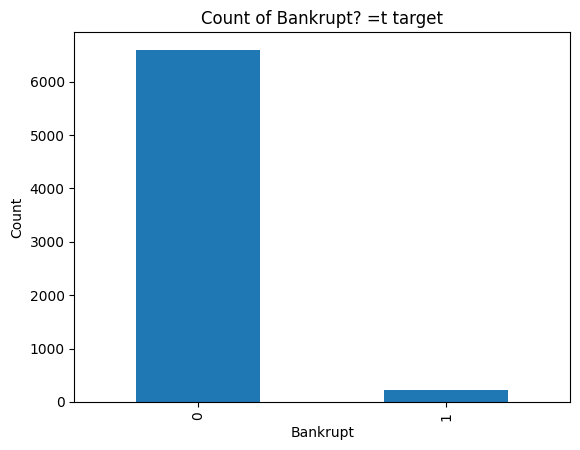

In [10]:
# Plot the count of the target variable
df['Bankrupt? =t  target'].value_counts().plot(kind='bar')
plt.title('Count of Bankrupt? =t target')
plt.xlabel('Bankrupt')
plt.ylabel('Count')

# Show the plot
plt.show()

In [11]:
# محاسبه میانگین و انحراف معیار
mean = df.mean()
std = df.std()

# استاندارد کردن داده‌ها (Z-Score)
df_standardized = (df - mean) / std

# تبدیل به بازه [0, 1]
df_normalized = (df_standardized - df_standardized.min()) / (df_standardized.max() - df_standardized.min())

df_normalized

,Bankrupt? =t target,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Equity to Liability
0,1.00000,0.37059,0.42439,0.40575,0.60146,0.60146,0.99897,0.79689,0.80881,0.30265,0.78098,0.00000,0.00000,0.45814,0.00000,0.00000,0.14795,0.14795,0.14795,0.16914,0.31166,0.00000,0.09592,0.13874,0.02210,0.84819,0.68898,0.68898,0.21754,0.49850,0.00000,0.26310,0.36373,0.00000,0.00000,0.62995,0.00000,0.20758,0.79242,0.00502,0.39028,0.00648,0.09588,0.13776,0.39804,0.08696,0.00000,0.00000,0.00000,0.00000,0.03290,0.00000,0.39291,0.00000,0.67278,0.16667,0.19064,0.00409,0.00000,0.00000,0.14731,0.33402,0.27692,0.00000,0.67627,0.72127,0.33908,0.00000,0.90322,0.00202,0.06486,0.07010,0.65500,0.59383,0.04580,0.67157,0.00000,0.67627,0.33908,0.12655,0.63756,0.45861,0.52038,0.31290,0.11825,0.00000,0.71685,0.00000,0.62288,0.60145,0.82789,0.29020,0.02660,0.56405,0.01647
1,1.00000,0.46429,0.53821,0.51673,0.61024,0.61024,0.99895,0.79738,0.80930,0.30356,0.78151,0.00000,0.00000,0.46187,0.00000,0.00000,0.18225,0.18225,0.18225,0.20894,0.31814,0.00000,0.09372,0.16992,0.02208,0.84809,0.68969,0.68970,0.21762,0.61161,0.00000,0.26452,0.37671,0.00000,0.00000,0.63517,0.00000,0.17118,0.82882,0.00506,0.37676,0.00584,0.09374,0.16896,0.39772,0.06447,0.00000,0.00000,0.93694,0.07197,0.02548,0.00000,0.39159,0.00000,0.75111,0.12724,0.18242,0.01495,0.00000,0.00000,0.05696,0.34111,0.28964,0.00000,0.30859,0.73198,0.32974,0.00000,0.93107,0.00223,0.02552,0.00000

In [12]:
df_normalized = df_normalized.drop_duplicates()
df_normalized.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6819 entries, 0 to 6818
Data columns (total 95 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Bankrupt? =t  target                                      6819 non-null   float64
 1    ROA(C) before interest and depreciation before interest  6819 non-null   float64
 2    ROA(A) before interest and % after tax                   6819 non-null   float64
 3    ROA(B) before interest and depreciation after tax        6819 non-null   float64
 4    Operating Gross Margin                                   6819 non-null   float64
 5    Realized Sales Gross Margin                              6819 non-null   float64
 6    Operating Profit Rate                                    6819 non-null   float64
 7    Pre-tax net Interest Rate                                6819 non-null   float64
 8    After-tax net Int

In [13]:
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format', '{:.5f}'.format)
df_normalized.describe().T

,count,mean,std,min,25%,50%,75%,max
Bankrupt? =t target,6819.00000,0.03226,0.17671,0.00000,0.00000,0.00000,0.00000,1.00000
ROA(C) before interest and depreciation before interest,6819.00000,0.50518,0.06069,0.00000,0.47653,0.50271,0.53556,1.00000
ROA(A) before interest and % after tax,6819.00000,0.55862,0.06562,0.00000,0.53554,0.55980,0.58916,1.00000
ROA(B) before interest and depreciation after tax,6819.00000,0.55359,0.06159,0.00000,0.52728,0.55228,0.58411,1.00000
Operating Gross Margin,6819.00000,0.60795,0.01693,0.00000,0.60044,0.60600,0.61391,1.00000
Realized Sales Gross Margin,6819.00000,0.60793,0.01692,0.00000,0.60043,0.60598,0.61384,1.00000
Operating Profit Rate,6819.00000,0.99876,0.01301,0.00000,0.99897,0.99902,0.99909,1.00000
Pre-tax net Interest Rate,6819.00000,0.79719,0.01287,0.00000,0.79739,0.79746,0.79758,1.00000
After-tax net Interest Rate,6819.00000,0.80908,0.01360,0.00000,0.80931,0.80938,0.80947,1.00000
Non-industry income and expenditure/revenue,6819.00000,0.30362,0.01116,0.00000,0.30347,0.30353,0.30359,1.00000


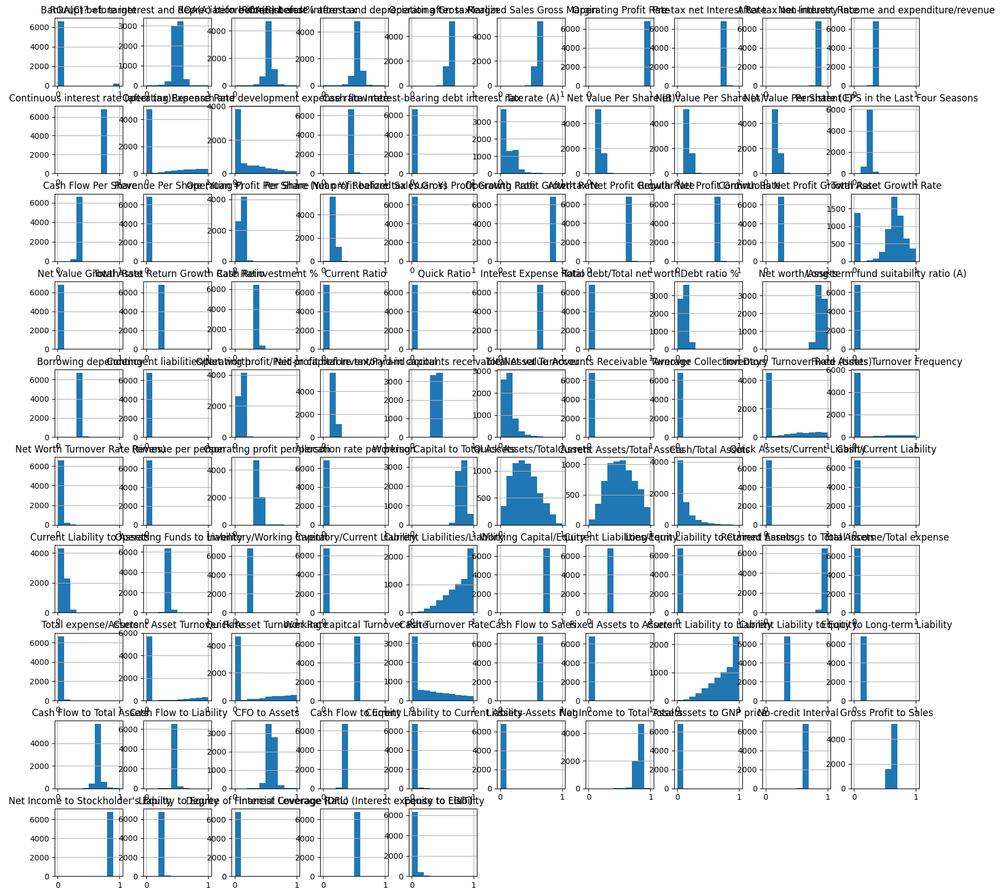

In [14]:
# Plot the distribution of all the features after StandardScaler
df_normalized.hist(figsize=(Siza_Of, Siza_Of))

# Show the plot
plt.show()

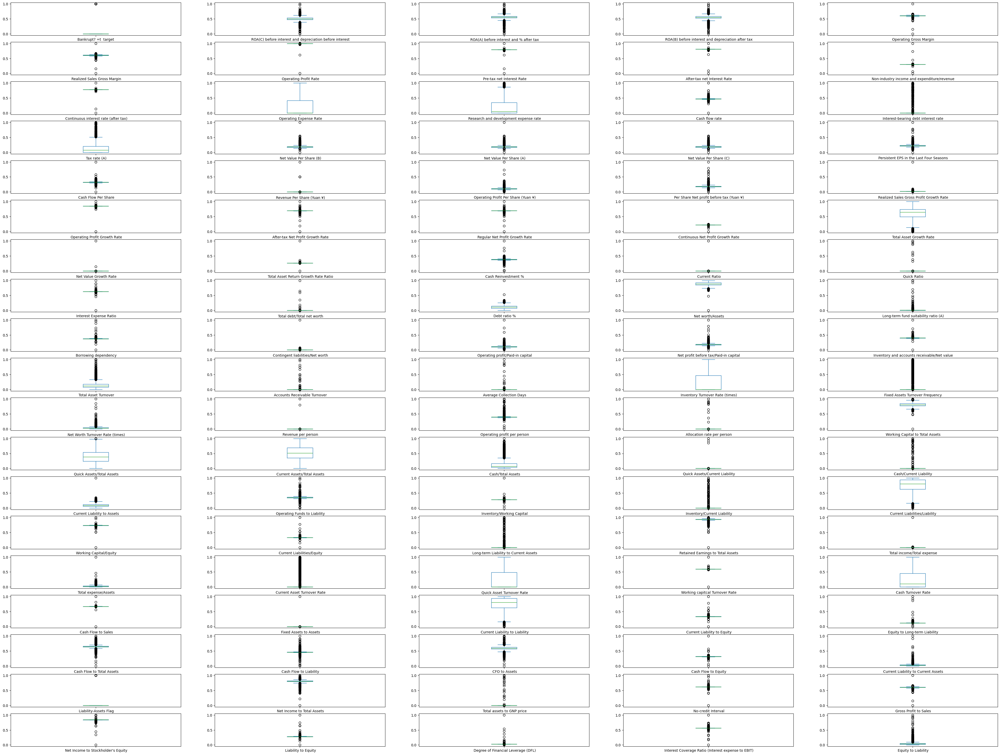

In [15]:
# Create boxplots of all columns
df_normalized.plot(kind='box', subplots=True, layout=(20, 5), figsize=(50, 40))

# Show the plot
plt.show()

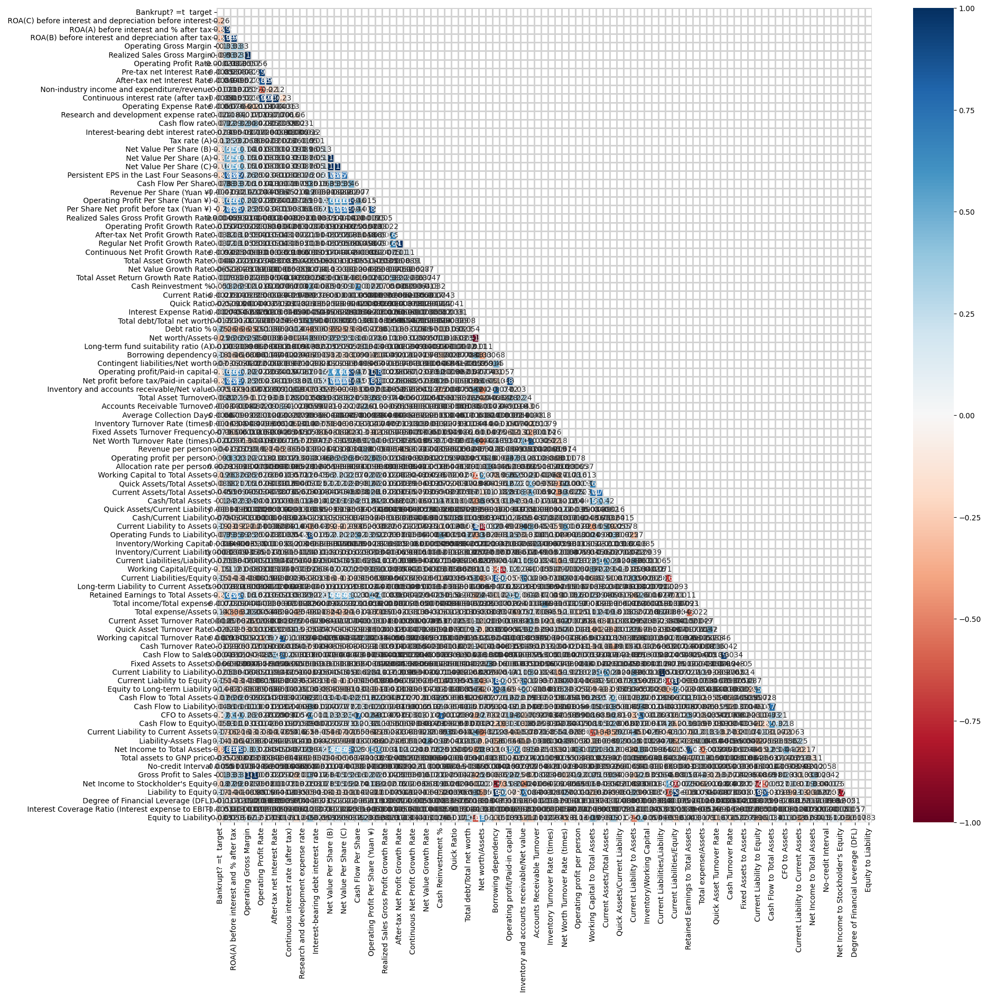

In [16]:
plt.figure(figsize = (Siza_Of,Siza_Of))

# ایجاد یک ماسک برای پنهان کردن مثلث بالا
mask = np.triu(np.ones_like(df_normalized.corr(), dtype=bool))

# رسم heatmap با استفاده از ماسک
sns.heatmap(df_normalized.corr(), mask = mask, annot = True, linewidths = 2, linecolor = 'lightgrey', cmap='RdBu')

# plt.show()
plt.savefig("heat map before high correlation fixed.png")

# کاهش ابعاد

## متغیر هایی که همبستگی بالای 0.8 دارند

In [17]:
df = df_normalized
target = df['Bankrupt? =t  target']
df.drop(columns=["Bankrupt? =t  target"], axis=1, inplace=True)

In [18]:
for i in range(10): # می توان بهینه تر نوشت
    correlation_matrix = df.corr().abs()
    # انتخاب ویژگی‌هایی که همبستگی بالاتر از 0.95 دارند
    upper_triangle = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool))
    processed_columns = set()  # مجموعه‌ای برای نگهداری ستون‌های پردازش شده
    # ادغام ستون‌هایی با همبستگی بالا
    for column in upper_triangle.columns:
        if column in processed_columns:
            continue  # اگر ستون قبلاً پردازش شده، به ستون بعدی بروید

        # پیدا کردن ستون‌های همبسته که در دیتافریم موجود هستند
        correlated_columns = [col for col in upper_triangle.index[upper_triangle[column] >= 0.8].tolist() if col in df.columns] + [column]
        
        if len(correlated_columns) > 1:  # اگر تعداد ستون‌های همبسته بیشتر از یک باشد
            new_column_name = "--------".join(correlated_columns)
            df[new_column_name] = df[correlated_columns].mean(axis=1)  # یا از تابع دیگری برای ادغام استفاده کنید
            df = df.drop(columns=correlated_columns)  # حذف ستون‌های اصلی همبسته
            processed_columns.update(correlated_columns)  # افزودن ستون‌ها به مجموعه پردازش‌شده

In [19]:
# Add `bankrupt_data` as a new column named `new_column` to the DataFrame
df['Bankrupt? =t  target'] = target

# Reposition the `new_column` to the second position (index 1)
df.insert(0, 'Bankrupt? =t  target', df.pop('Bankrupt? =t  target'))

df.shape

(6819, 73)

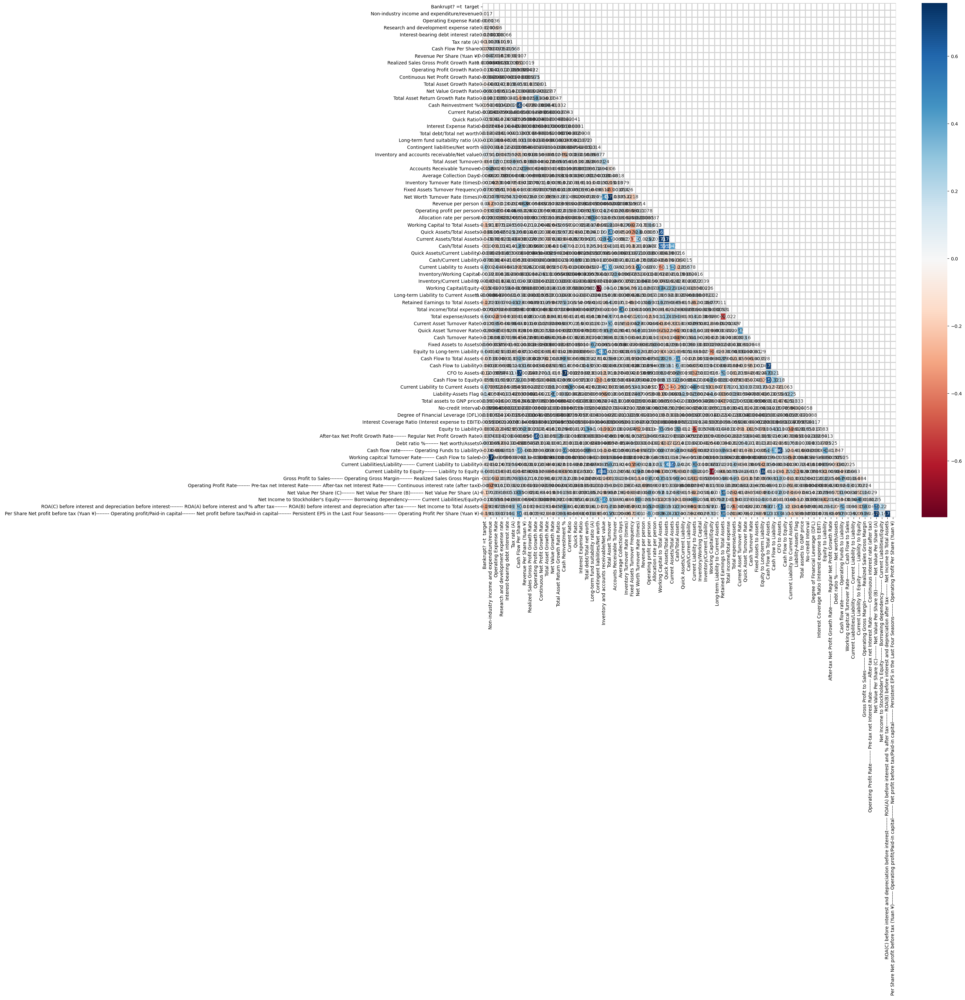

In [20]:
plt.figure(figsize = (Siza_Of,Siza_Of))

# ایجاد یک ماسک برای پنهان کردن مثلث بالا
mask = np.triu(np.ones_like(df.corr(), dtype=bool))

# رسم heatmap با استفاده از ماسک
sns.heatmap(df.corr(), mask=mask, annot = True, linewidths = 2, linecolor = 'lightgrey', cmap='RdBu')

# plt.show()
plt.savefig("heat map after high correlation fixed.png")

In [21]:
# فرض کنیم df داده‌ها را شامل می‌شود
for column in df.columns:
    if df[column].dtype in ['int64', 'float64']:  # چک کردن اینکه ستون‌ها عددی باشند
        fig = px.box(df, y=column, title=f'Box Plot for {column}')
        fig.show()

In [ ]:
# Select only numeric columns from the DataFrame
numeric_cols = df.select_dtypes(include=['number'])

# Determine the number of numeric columns
num_cols = len(numeric_cols.columns)

# Create a figure and set of subplots
fig, axes = plt.subplots(nrows=27, ncols=4, figsize=(30, (num_cols + 1) // 2 * 4))
axes = axes.flatten()  # Flatten the array of axes for easy indexing

# Iterate over each numeric column in the DataFrame
for i, col in enumerate(numeric_cols.columns):
    # Compute the 1st quartile (Q1), 3rd quartile (Q3), and the Interquartile Range (IQR)
    Q1 = numeric_cols[col].quantile(0.25)
    Q3 = numeric_cols[col].quantile(0.75)
    IQR = Q3 - Q1

    # Identify outliers using the IQR method
    outliers = (numeric_cols[col] < (Q1 - 1.5 * IQR)) | (numeric_cols[col] > (Q3 + 1.5 * IQR))

    # Create a new column for the outliers (True = Outlier, False = Not Outlier)
    df[f'outlier_{col}'] = outliers

    # Map 'True' (outliers) to 'red' and 'False' (normal) to 'blue'
    colors = outliers.map({True: 'red', False: 'blue'})

    # Plot the feature values with outliers highlighted in the corresponding subplot
    axes[i].scatter(df.index, numeric_cols[col], c=colors, alpha=0.6)
    axes[i].set_xlabel('Index')
    axes[i].set_ylabel('Feature Value')
    axes[i].set_title(f' {col}')
    axes[i].grid(True)

# Turn off any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])  # Remove unused axes

# Adjust layout
plt.tight_layout()
plt.show()

In [24]:
# Select only numeric columns from the DataFrame
numeric_cols = df.select_dtypes(include=['number'])

# Number of numeric columns
num_cols = len(numeric_cols.columns)

# Set up the matplotlib figure
fig, axes = plt.subplots(nrows=20, ncols=4, figsize=(30, (num_cols + 1) // 2 * 4))
axes = axes.flatten()  # Flatten the array of axes for easy indexing

# Plot each numeric column
for i, col in enumerate(numeric_cols.columns):
    # Create a displot for each numeric column
    sns.histplot(numeric_cols[col], kde=True, ax=axes[i], bins=30)

    # Set titles and labels
    axes[i].set_title(f'Distribution Plot for {col}')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Frequency')

# Adjust layout
plt.tight_layout()
plt.show()